In [65]:
import tensorflow as tf
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt

#### Loading data

In [6]:
x = pd.read_csv("butterfly/butterfly/training_set.csv")

In [7]:
x 

,filename,label
0,Image_1.jpg,SOUTHERN DOGFACE
1,Image_2.jpg,ADONIS
2,Image_3.jpg,BROWN SIPROETA
3,Image_4.jpg,MONARCH
4,Image_5.jpg,GREEN CELLED CATTLEHEART
...,...,...
6494,Image_6495.jpg,MANGROVE SKIPPER
6495,Image_6496.jpg,MOURNING CLOAK
6496,Image_6497.jpg,APPOLLO
6497,Image_6498.jpg,ELBOWED PIERROT


In [19]:
s= datafrom_dir.class_names


In [48]:
Frame=pd.DataFrame({"Class":np.arange(1,76),"class_label":s})

In [49]:
Frame

,Class,class_label
0,1,ADONIS
1,2,AFRICAN GIANT SWALLOWTAIL
2,3,AMERICAN SNOOT
3,4,AN 88
4,5,APPOLLO
...,...,...
70,71,ULYSES
71,72,VICEROY
72,73,WOOD SATYR
73,74,YELLOW SWALLOW TAIL


In [50]:
Frame.shape

(75, 2)

In [51]:
datafrom_dir = tf.keras.utils.image_dataset_from_directory(directory='butterfly/butterfly/train',image_size=(64, 64),batch_size=100)

Found 6499 files belonging to 75 classes.


In [52]:
train_ds = datafrom_dir.map(lambda x,y:(x/255,y))

In [53]:
len(train_ds)

65

In [54]:
train_ds.as_numpy_iterator().next()

(array([[[[4.57352936e-01, 5.28676450e-01, 4.63725477e-01],
          [4.37009811e-01, 5.11519611e-01, 4.37009811e-01],
          [4.35049027e-01, 5.09558797e-01, 4.31127459e-01],
          ...,
          [4.79901969e-01, 5.82843125e-01, 5.29901981e-01],
          [4.78186280e-01, 5.72303951e-01, 5.17401934e-01],
          [4.69607830e-01, 5.52450955e-01, 5.00735283e-01]],
 
         [[4.73284304e-01, 5.36029398e-01, 4.85049009e-01],
          [4.35294122e-01, 5.05882382e-01, 4.43137258e-01],
          [4.35539216e-01, 5.17892182e-01, 4.43382353e-01],
          ...,
          [4.70833331e-01, 5.76715708e-01, 5.10049045e-01],
          [4.33578432e-01, 5.27696073e-01, 4.64950979e-01],
          [4.30882365e-01, 5.21078408e-01, 4.58333343e-01]],
 
         [[4.77450967e-01, 5.48039198e-01, 4.99019593e-01],
          [4.42156851e-01, 5.22303939e-01, 4.64215696e-01],
          [4.36519593e-01, 5.26715696e-01, 4.56127465e-01],
          ...,
          [4.83578444e-01, 5.85539222e-01, 5.3455

In [55]:
len(train_ds)

65

#### Data Augmentation

In [56]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.3),
    tf.keras.layers.RandomZoom(.3)
])

In [57]:
train_ds = train_ds.map(lambda x, y: (data_augmentation(x, training=True), y))

#### Spliting data

In [58]:
train_size = int(len(train_ds)*.7)+1
print(train_size)
val_size = int(len(train_ds)*.3)
print(val_size)

46
19


In [59]:
train = train_ds.take(train_size)
val = train_ds.skip(train_size).take(val_size)

In [60]:
len(train)

46

In [61]:
len(val)

19

#### sample Images of classes  

In [98]:
dir_path = "butterfly/butterfly/train" 
# for k in os.listdir(dir_path):
#      print(k)

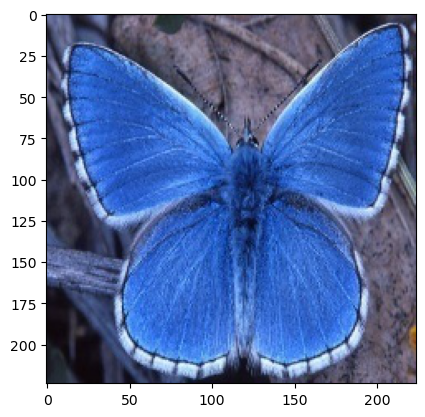

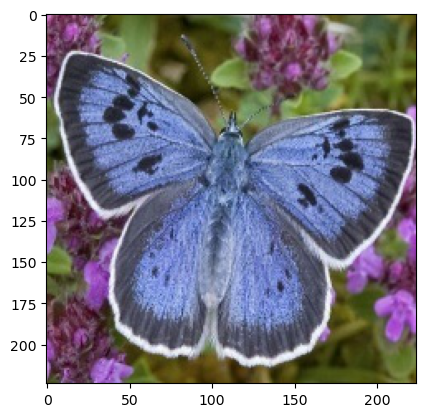

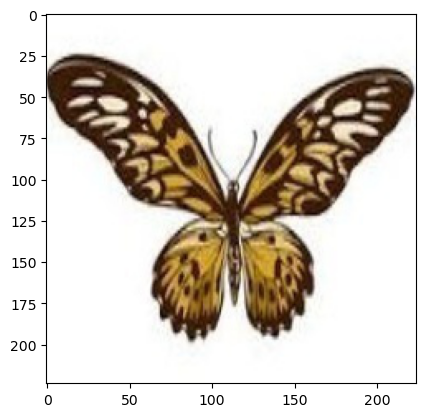

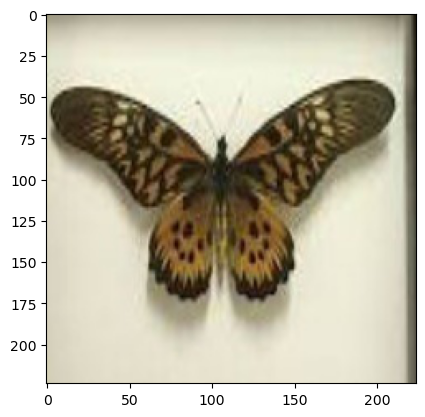

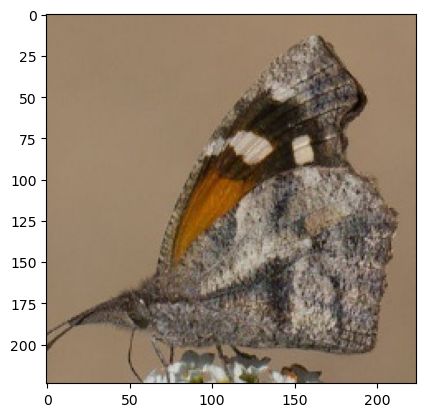

...

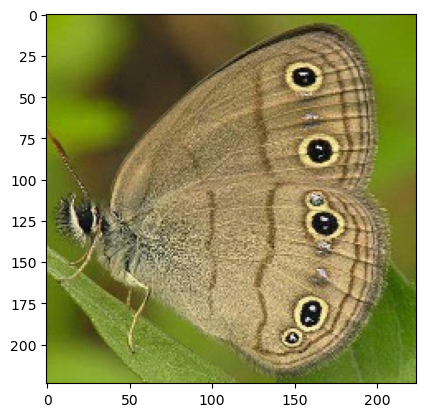

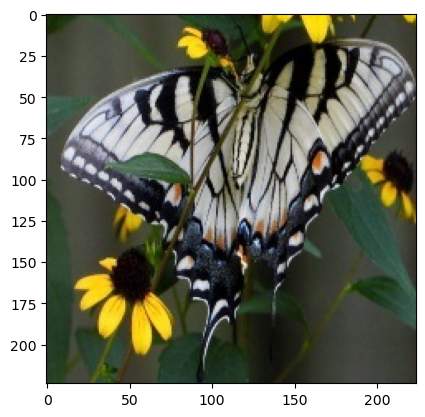

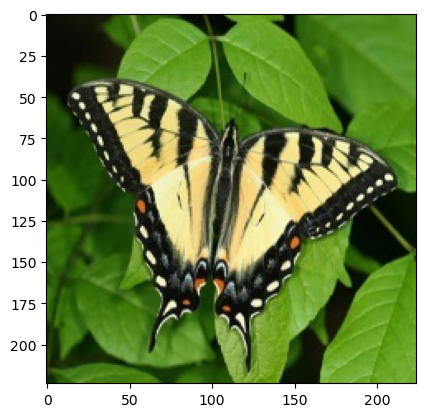

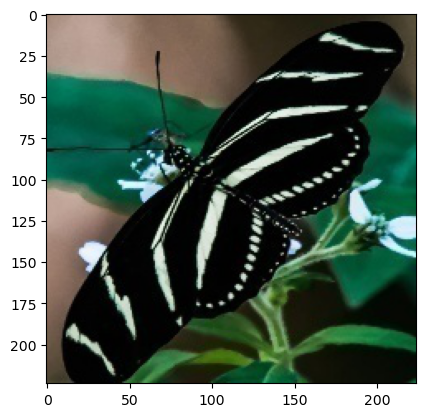

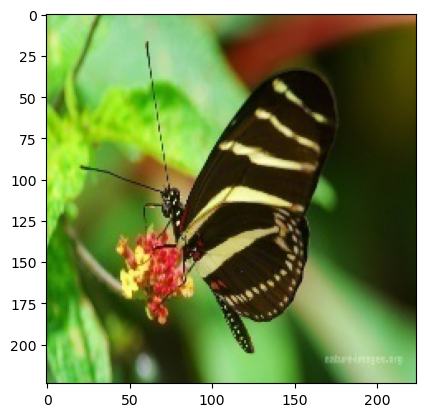

In [99]:
l1=[]
for k in os.listdir(dir_path):
    j=0
    for i in os.listdir("butterfly/butterfly/train/{}".format(k)):
        img = tf.keras.preprocessing.image.load_img("butterfly/butterfly/train/{}".format(k)+"//"+i)
        l1.append(img)
        plt.imshow(img)
        plt.show()
        j=j+1
        if j>1:
            break

### Building CNN

In [74]:
cnn = tf.keras.models.Sequential()

In [75]:
cnn.add(tf.keras.layers.Conv2D(filters=32,kernel_size=3,activation='relu',input_shape=[64,64,3]))
cnn.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2)))
cnn.add(tf.keras.layers.Dropout(0.2))
cnn.add(tf.keras.layers.Conv2D(filters=64,kernel_size=3, activation='relu'))
cnn.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2)))
cnn.add(tf.keras.layers.Dropout(0.3))   
cnn.add(tf.keras.layers.Conv2D(filters=128,kernel_size=3, activation='relu'))
cnn.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2)))
cnn.add(tf.keras.layers.Dropout(0.4))   
cnn.add(tf.keras.layers.Flatten())
cnn.add(tf.keras.layers.Dropout(0.5))   
# cnn.add(tf.keras.layers.Dense(units=200,activation='relu'))
cnn.add(tf.keras.layers.Dense(units=150,activation='relu'))
cnn.add(tf.keras.layers.Dense(units=100,activation='relu'))
# cnn.add(tf.keras.layers.Dropout(0.5))
cnn.add(tf.keras.layers.Dense(units=75,activation='softmax'))


C:\Users\kanub\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [76]:
cnn.compile(optimizer='adam',loss="sparse_categorical_crossentropy",metrics=['accuracy'])    

#### Early Stopping

In [77]:
# Early Stopping
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)

In [78]:
hist = cnn.fit(x=train,validation_data=val,epochs=35,callbacks=[early_stopping])

Epoch 1/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 48s 951ms/step - accuracy: 0.0174 - loss: 4.3206 - val_accuracy: 0.0474 - val_loss: 4.2134
Epoch 2/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 41s 880ms/step - accuracy: 0.0356 - loss: 4.1211 - val_accuracy: 0.0606 - val_loss: 3.8734
Epoch 3/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 52s 1s/step - accuracy: 0.0558 - loss: 3.8309 - val_accuracy: 0.1027 - val_loss: 3.5782
Epoch 4/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 77s 969ms/step - accuracy: 0.1147 - loss: 3.5470 - val_accuracy: 0.1395 - val_loss: 3.2921
Epoch 5/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 39s 835ms/step - accuracy: 0.1458 - loss: 3.2335 - val_accuracy: 0.2117 - val_loss: 2.9227
Epoch 6/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 40s 857ms/step - accuracy: 0.2023 - loss: 2.9806 - val_accuracy: 0.2622 - val_loss: 2.7808
Epoch 7/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 39s 823ms/step - accuracy: 0.2320 - loss: 2.7932 - val_accuracy: 0.2812 - val_loss: 2.6532
Epoch 8/35
46/46 ━━━━━━━━━━━━━━━━━━━━ 41s 879ms/step - accuracy: 0.2685 - loss: 2.6452 - val_accurac

In [79]:
cnn.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)                    │ (None, 62, 62, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 31, 31, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 31, 31, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 29, 29, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 14, 14, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 14, 14, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 12, 12, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 6, 6, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 6, 6, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 4608)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 4608)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 150)                 │         691,350 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 100)                 │          15,100 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 75)                  │           7,575 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,421,821 (9.24 MB)

 Trainable params: 807,273 (3.08 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 1,614,548 (6.16 MB)

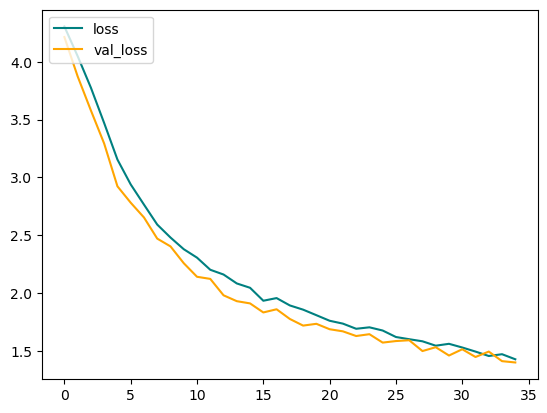

In [80]:

plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
plt.legend(loc='upper left')
plt.show()


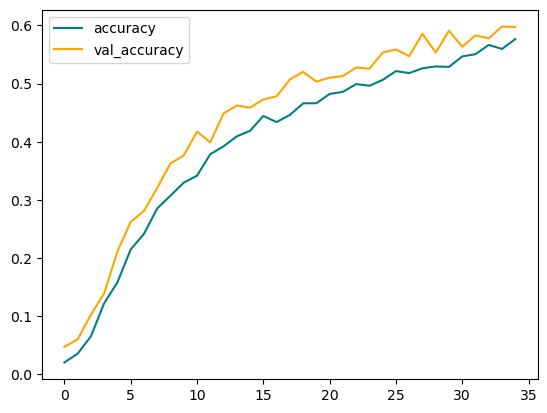

In [81]:
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
plt.legend(loc='upper left')
plt.show()


### Test Folder Image Prediction


In [95]:
def predict_image_category(model, image_path, class_names):
    img = tf.keras.utils.load_img(image_path, target_size=(64, 64))  # Adjust target_size to match your model's input size
    img_array = tf.keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)  # Create a batch
    
    img_array = img_array / 255.0
    
    predictions = cnn.predict(img_array)
    
    # Get the predicted class index
    predicted_class_index = np.argmax(predictions[0])
    
    # Get the predicted class name
    predicted_class_name = class_names[predicted_class_index]
    
    return predicted_class_index,predicted_class_name



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


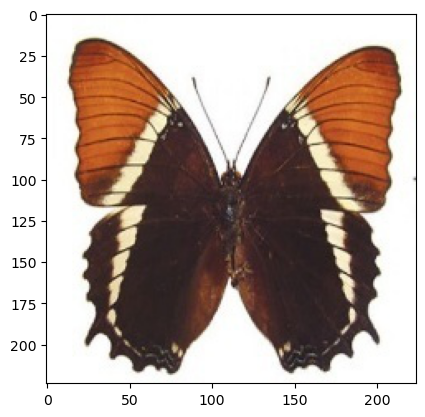

The predicted class and category is: (12, 'BROWN SIPROETA')


In [106]:
class_names  = datafrom_dir.class_names
image_path = "butterfly/butterfly/test/Image_155.jpg"
predicted_category = predict_image_category(cnn, image_path, class_names)
plt.imshow(tf.keras.preprocessing.image.load_img(image_path))
plt.show()
print(f"The predicted class and category is: {predicted_category}")